##**Custom Keypoint detection using Tensorflow Object detection API**

This notebook helps you train a keypoint detection model on custom dataset annotated in coco format. We are using Centernet-hourglass  model.
This codebase contains scripts for TF record generation, model training and inference.

###Mount Google drive

###Download Tensorflow model repository into the gdrive workspace

Download des libs tensorflow

In [ ]:
#We clone the TensorFlow Model Garden repository
!git clone https://github.com/tensorflow/models.git

It is not mandatory but it can be interesting to go on the git because the author explains the process to follow. 

In [ ]:
#! git -C /content clone  https://github.com/prabhakar-sivanesan/Custom-keypoint-detection

Download dataset from google drive

In [ ]:
#Download dataset from google drive
%cd /content/
!pip install --upgrade --no-cache-dir gdown
!gdown 1qSdXKJP44joNIIHetLg58bhryhQ6WCmu

We dezip the dataset. The folder must be called "dataset".

In [ ]:
!unzip /content/dataset.zip -d /content/

###Installing dependencies

In [ ]:
! pip3 install --user -r /content/models/official/requirements.txt
!apt-get install protobuf-compiler python-lxml python-pil
!pip install Cython pandas tf-slim lvis

In [ ]:
!cp /content/models/research/object_detection/packages/tf2/setup.py .
!python -m pip install --use-feature=2020-resolver .

In [ ]:
#reinstall opencv with headless
!pip list | grep opencv
!pip uninstall opencv-python -y
!pip install "opencv-python-headless<4.3"
!pip list | grep opencv

We go to the "protos" folder and compile the .proto files that are inside

In [ ]:
%cd /content/models/research/
!protoc object_detection/protos/*.proto --python_out=.

We add the new library

In [ ]:
import sys
import os
ROOT_DIR = os.path.abspath("/content/models/research/")
sys.path.append(ROOT_DIR)  # To find local version of the library

In [ ]:
!pip install tensorflow_io
!pip install tf-models-official

###Download pretrained model from TF model garden

/content/Custom-keypoint-detection/pretrained_model

In [ ]:
#We download from google drive our already trained model
%cd /content/
!pip install --upgrade --no-cache-dir gdown
!gdown 1T1NDrZBrUfqY4j8JivrFHqYo_KYO1ECT

In [ ]:
#We dezip the model. The folder must be called "saved_model".
!unzip /content/saved_model.zip -d /content/

The step above is not to be done if you want to start over. In this case it is necessary to execute the step below

In [ ]:
#If we haven't trained a model yet or if we want to start from the beginning we go to the "pretrained_model" folder and download it from tensorflow
%cd "/content/pretrained_model"

!wget "http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_512x512_kpts_coco17_tpu-32.tar.gz"
!tar -xvzf "centernet_hg104_512x512_kpts_coco17_tpu-32.tar.gz"

###Generate TFrecord from coco annotation dataset

This step has to be executed after the dataset is split for training, validation and testing.

In [ ]:
!pip install funcy

In [ ]:
#We separate the dataset into 0.7 for the train and 0.3 for the validation set
#                                         |split ratio                      |destination of the new json for the train                
#                                              |path to the coco annotation of the dataset                  |destination of the new json for validation
!python /content/split_coco_dataset.py -s 0.7  /content/dataset/train.json /content/dataset/train_data.json /content/dataset/validation_data.json

Saved 1017 entries in /content/dataset/train_data.json and 436 in /content/dataset/validation_data.json


In [ ]:
#Creation of tfrecords
!python /content/generate_tfrecord_from_coco.py --train_image_dir "/content/dataset/train" \
--test_image_dir "/content/dataset/train" \
--val_image_dir "/content/dataset/train" \
--train_annotations_file "/content/dataset/train_data.json" \
--testdev_annotations_file "/content/dataset/validation_data.json" \
--val_annotations_file "/content/dataset/validation_data.json" \
--train_keypoint_annotations_file "/content/dataset/train_data.json" \
--val_keypoint_annotations_file "/content/dataset/validation_data.json" \
--output_dir "/content/tfrecord"

### Run Tensorboard
Open tensorboard to monitor the training performance.

In [ ]:
%cd '/content/Custom-keypoint-detection'
#start the Tensorboard
#%load_ext tensorboard
%reload_ext tensorboard
%tensorboard --logdir=/content/output_models/

/content/Custom-keypoint-detection


<IPython.core.display.Javascript object>

### Model Training

In [ ]:
#Creation of an outputs_models folder for monitoring and saving
import os
os.mkdir('/content/output_models')

/content/models/research/object_detection/model_main_tf2.py

In [ ]:
ROOT_DIR = os.path.abspath("/content/models/research")
sys.path.append(ROOT_DIR)  # To find local version of the library

#Start training
!python /content/models/research/object_detection/model_main_tf2.py \
--model_dir "/content/output_models" \
--pipeline_config_path "/content/pipeline.config" # config file

2023-01-27 11:04:13.630430: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-27 11:04:13.786172: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-27 11:04:14.640285: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-27 11:04:14.640377: W tensorflow/compiler/xla/stream_executor

### Export saved model
Export saved model from the trained checkpoint.

/content/models/research/object_detection/exporter_main_v2.py

In [ ]:
%cd "/content/Custom-keypoint-detection"
!python /content/models/research/object_detection/exporter_main_v2.py \
--input_type image_tensor \
--pipeline_config_path "/content/pipeline.config" \
--trained_checkpoint_dir "/content/output_models" \
--output_directory "/content/saved_model"

/content/Custom-keypoint-detection
2023-01-27 17:27:46.354410: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-27 17:27:46.531850: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-27 17:27:47.518846: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-27 17:27:47.518935: W tens

### Run inference

In [ ]:
!pip install opencv-python

In [ ]:
!pip uninstall opencv-python-headless

In [ ]:
!pip install opencv-contrib-python

You have to create an "output_folder". This folder will contain the result of prediction on test images

In [ ]:
#You have to modify the header of the file inference.py according to the path of the folders
!python inference.py

2023-01-27 17:37:27.046629: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-27 17:37:27.186841: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-01-27 17:37:27.920119: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/local/lib/python3.8/dist-pa

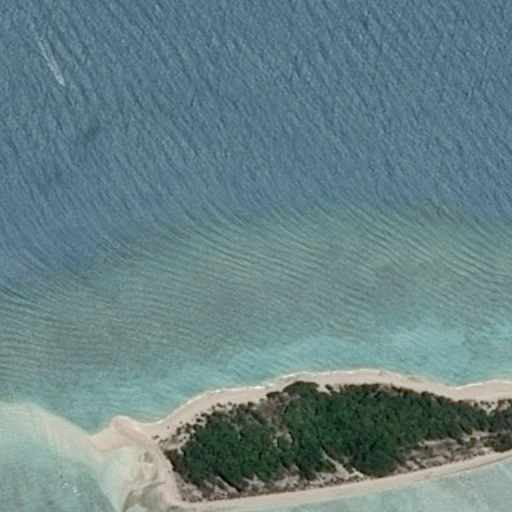

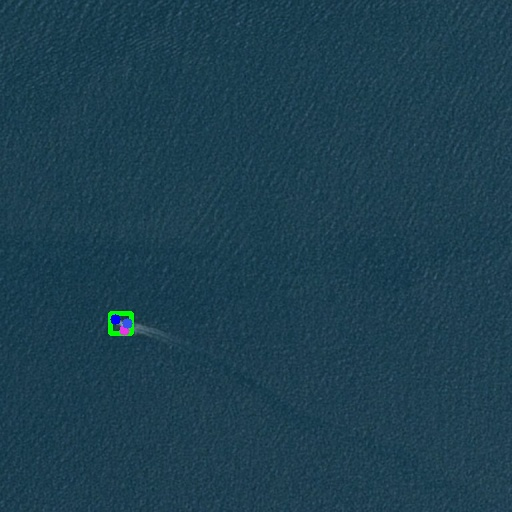

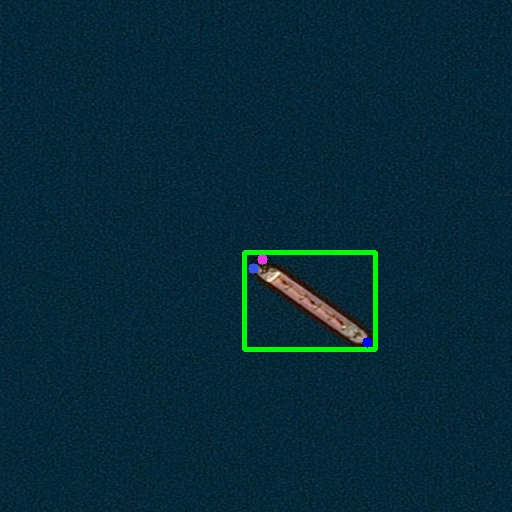

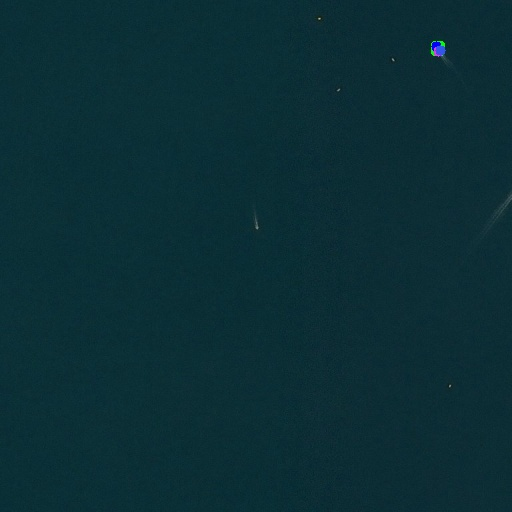

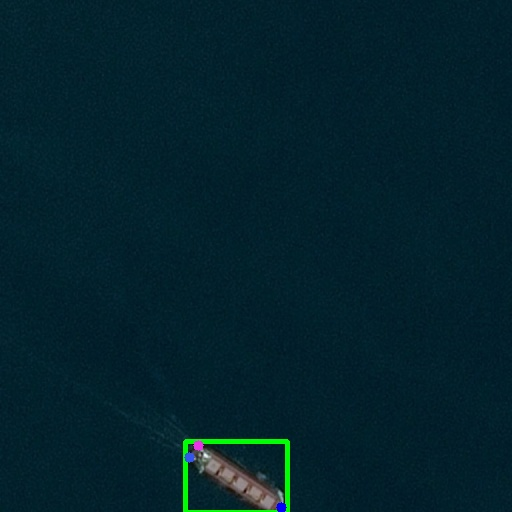

...

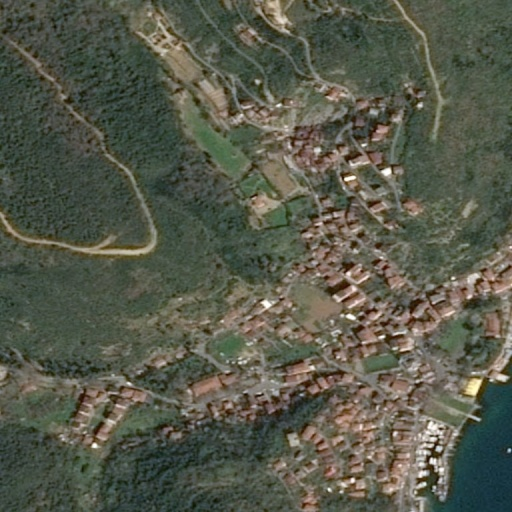

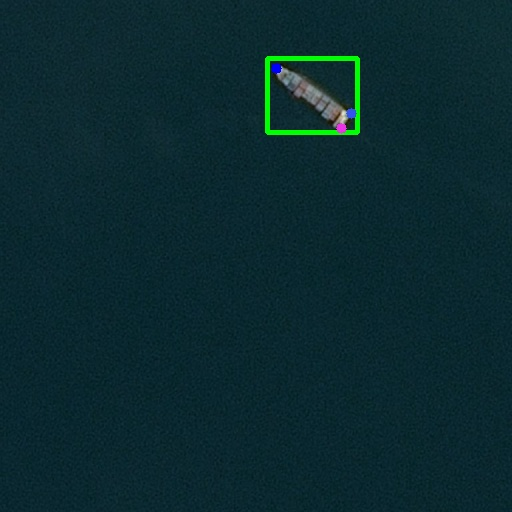

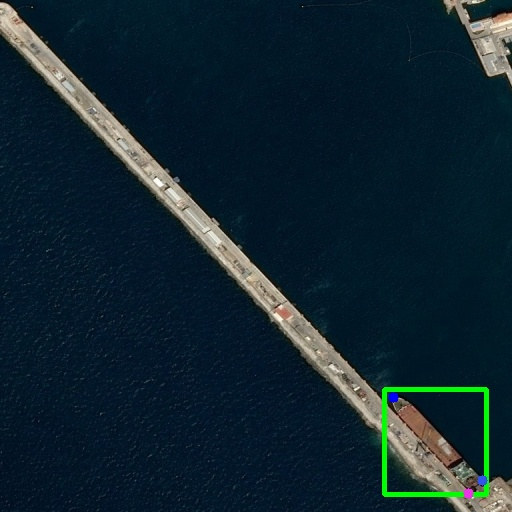

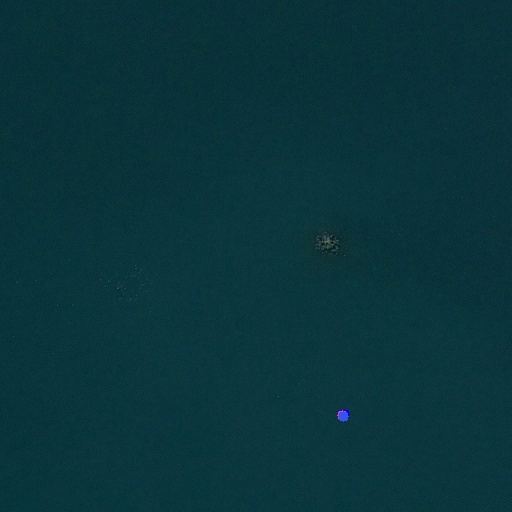

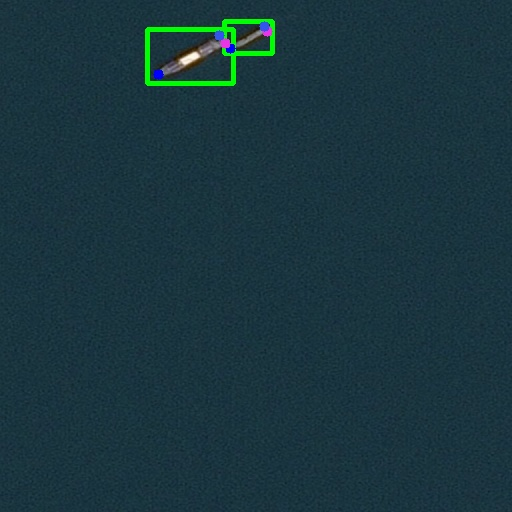

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import os

img_list = os.listdir('/content/output_folder/')
for image in img_list:
  img = cv2.imread('/content/output_folder/' + image)
  cv2_imshow(img)